Module- Artificial Intelligence

Module ID -

Topic - Galaxy Morphological Classification Using Convolutional Neural networks (CNN)

Student Name- Vishvapriya Sangvikar

Student ID- 2415083

Leeds Trinity University

In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

'''import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All"
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session'''

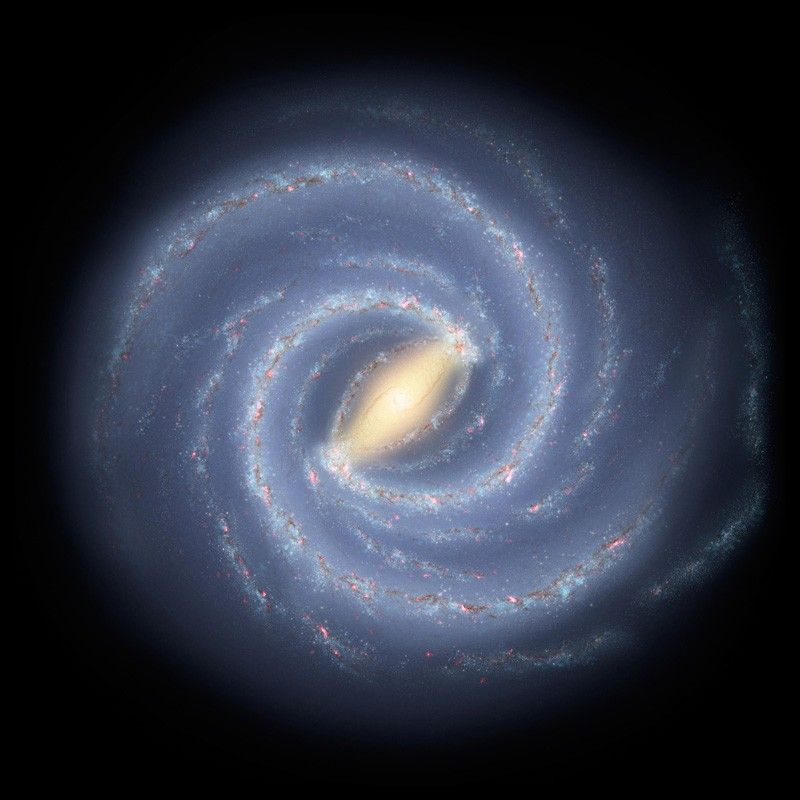

The Milky Way Galaxy

NASA/JPL-Caltech

# Theory

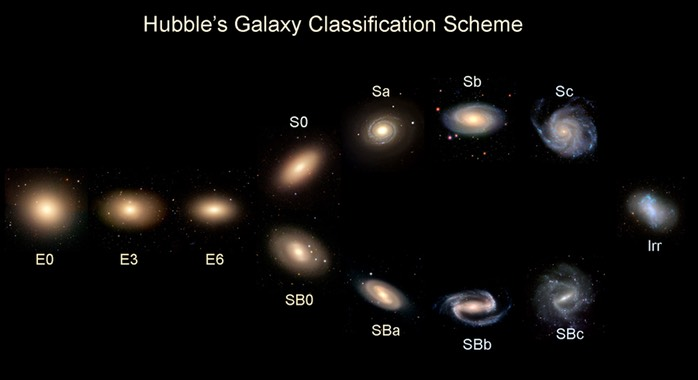

## What is a galaxy?

Galaxies are vast systems of stars, stellar remnants, interstellar gas, dust, and dark matter, bound together by gravity. They range in size from dwarfs with just a few hundred million stars to giants with one hundred trillion stars, each orbiting its galaxy's center of mass. Galaxies are categorized based on their visual morphology, primarily into three main types: elliptical, spiral, and irregular.


### Galaxy Classification

Galaxies are classified based on their shape, structure, and how bright they appear. This classification helps astronomers understand the different types of galaxies and how they might have formed and evolved. The most common system for classifying galaxies is the Hubble Sequence, which groups galaxies into three main types: spiral, elliptical, and irregular.





# About the dataset

For this project, I have selected the dataset from Kaggle.

Link of the dataset- Resized and Reduced Galaxy Zoo 2 Images. (n.d.). Www.kaggle.com. https://www.kaggle.com/datasets/robertmifsud/resized-reduced-gz2-images


Reference Code - blaisehu. (2024, April 24). TensorFlow CNN and Xception. Kaggle.com; Kaggle. https://www.kaggle.com/code/blaisehu/tensorflow-cnn-and-xception


Models used in the project for comparison-
Custom CNN, Xception and ResNet



# Importing the libraries

In [ ]:
# General ibraries
import polars as pl
import numpy as np
import warnings
import math
from PIL import Image
from pathlib import Path
from multiprocessing import Pool


In [ ]:
# Plotting libraries
import plotly
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.io as pio


In [ ]:
# Model
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam, RMSprop
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from keras import backend as K


In [ ]:
# Metrics
from sklearn.metrics import (confusion_matrix,
                             accuracy_score,
                             f1_score,
                             recall_score,
                             precision_score)

In [ ]:
# Setting the plotly theme
import plotly.io as pio
pio.templates.default = "seaborn"

# Filter warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

# Dataset Preparation

In [ ]:

# Defining categories and encoding
CATS = ['E', 'S', 'SB']
CATS_TO_IDX = {v: k for k, v in enumerate(CATS)}
IDX_TO_CATS = {k: v for k, v in enumerate(CATS)}

# Define categories colors
CATS_COLORS = ['red', 'blue', 'green']
COLOR_MAP = {k: v for k, v in zip(CATS, CATS_COLORS)}

#Define images shapes
SHAPES = ['small', 'medium', 'large']

# Data preparation
TEST_FRAC = 0.3

# Models params
IMG_PARAMS = {
    'small':{
        'height': 69,
        'width': 69,
        'channels': 3,
    },
    'medium':{
        'height': 227,
        'width': 227,
        'channels': 3
    },
    'large':{
        'height': 299,
        'width': 299,
        'channels': 3
    }
}
TRAIN_PATH = Path('/kaggle/working/train')
TEST_PATH = Path('/kaggle/working/test')
AUTOTUNE = tf.data.AUTOTUNE
BATCH_SIZE = 32
TRAIN_TEST_SPLIT = 0.3
EPOCHS = 30

## RUN only
RUN_ONLY = False


**Defining the project paths**

In [ ]:

project_path = Path('/kaggle/input/resized-reduced-gz2-images')
path_69 = project_path.joinpath('images_E_S_SB_69x69_a_03')
path_227 = project_path.joinpath('images_E_S_SB_227x227_a_03')
path_299 = project_path.joinpath('images_E_S_SB_299x299_a_03')
path_csv = project_path.joinpath('3class_map_a(p).csv')

# Data Preprocessing

In [ ]:
df = pl.read_csv(path_csv)
df.head(10)

,dr7objid,asset_id,gz2class,total_classifications,total_votes,agreement
i64,i64,i64,str,i64,i64,f64
0,587732591714893851,58957,"""Sc+t""",45,342,1.0
1,588009368545984617,193641,"""Sb+t""",42,332,1.0
2,587732484359913515,55934,"""Ei""",36,125,0.384527
3,587741723357282317,158501,"""Sc+t""",28,218,0.766954
4,587738410866966577,110939,"""Er""",43,151,0.399222
5,587729751132209314,249897,"""Ei""",48,154,0.532355
6,587733608555216981,71801,"""Ei""",39,142,0.235888
7,587735742617616406,87614,"""Sb+t""",35,282,1.0
8,587738574068908121,113304,"""Ei""",50,158,0.503446


In [ ]:
df.tail(10)

,dr7objid,asset_id,gz2class,total_classifications,total_votes,agreement
i64,i64,i64,str,i64,i64,f64
206158,587741820528689370,264076,"""Ec""",42,144,0.302683
206159,587729158440681699,30593,"""Er""",42,150,0.459027
206160,587734841742459081,74398,"""Ei""",40,113,0.278072
206161,587741531712782408,151540,"""Ec""",42,133,0.537734
206162,587739153356030180,259387,"""Ec""",43,166,0.285699
206163,587741490371625059,262969,"""Ec""",42,135,0.491097
206164,587731174917669027,275883,"""Ei(i)""",46,186,0.088327
206165,587731512070177108,282536,"""Ei""",48,164,0.333635
206166,587731513145688256,284172,"""Ei(i)""",48,204,0.077605


In [ ]:
df.shape

(206168, 7)

In [ ]:
print("DataFrame Shape:")
print(f"Rows: {df.height}, Columns: {df.width}")

DataFrame Shape:
Rows: 206168, Columns: 7


In [ ]:
df.describe()

statistic,,dr7objid,asset_id,gz2class,total_classifications,total_votes,agreement
str,f64,f64,f64,str,f64,f64,f64
"""count""",206168.0,206168.0,206168.0,"""206168""",206168.0,206168.0,206168.0
"""null_count""",0.0,0.0,0.0,"""0""",0.0,0.0,0.0
"""mean""",103083.5,5.8782e17,141056.802763,null,42.622196,184.118694,0.43431
"""std""",59515.719487,1.8327e14,81082.330522,null,5.910699,63.328847,0.28728
"""min""",0.0,5.8772e17,3.0,"""Ec""",16.0,32.0,0.0
"""25%""",51542.0,5.8773e17,71370.0,null,39.0,141.0,0.17935
"""50%""",103084.0,5.8774e17,139530.0,null,43.0,160.0,0.456436
"""75%""",154625.0,5.8774e17,210903.0,null,46.0,207.0,0.632321
"""max""",206167.0,5.8885e17,295305.0,"""Sd?t(r)""",79.0,604.0,1.0


In [ ]:
print("Missing Values:")
print(df.null_count())

Missing Values:
shape: (1, 7)
┌─────┬──────────┬──────────┬──────────┬───────────────────────┬─────────────┬───────────┐
│     ┆ dr7objid ┆ asset_id ┆ gz2class ┆ total_classifications ┆ total_votes ┆ agreement │
│ --- ┆ ---      ┆ ---      ┆ ---      ┆ ---                   ┆ ---         ┆ ---       │
│ u32 ┆ u32      ┆ u32      ┆ u32      ┆ u32                   ┆ u32         ┆ u32       │
╞═════╪══════════╪══════════╪══════════╪═══════════════════════╪═════════════╪═══════════╡
│ 0   ┆ 0        ┆ 0        ┆ 0        ┆ 0                     ┆ 0           ┆ 0         │
└─────┴──────────┴──────────┴──────────┴───────────────────────┴─────────────┴───────────┘


In [ ]:
import polars as pl


# Checking for duplicate rows
duplicate_rows = df.filter(df.is_duplicated()).height
print(f"Number of duplicate rows: {duplicate_rows}")

# Checking for duplicates in 'dr7objid' (unique identifier for galaxies)
duplicate_dr7objid = df.filter(df['dr7objid'].is_duplicated()).height
print(f"Number of duplicates in 'dr7objid': {duplicate_dr7objid}")

Number of duplicate rows: 0
Number of duplicates in 'dr7objid': 0


In [ ]:
from pathlib import Path

# Define project path
project_path = Path('/kaggle/input/resized-reduced-gz2-images')

# Define paths for different image sizes and CSV file
path_69 = project_path.joinpath('images_E_S_SB_69x69_a_03')
path_227 = project_path.joinpath('images_E_S_SB_227x227_a_03')
path_299 = project_path.joinpath('images_E_S_SB_299x299_a_03')
path_csv = project_path.joinpath('3class_map_a(p).csv')

# Define train and test subfolders for each image size
train_69 = path_69 / 'train'
test_69 = path_69 / 'test'

train_227 = path_227 / 'train'
test_227 = path_227 / 'test'

train_299 = path_299 / 'train'
test_299 = path_299 / 'test'

# Verify paths
print("Path to 69x69 train images:", train_69)
print("Path to 69x69 test images:", test_69)
print("Path to 227x227 train images:", train_227)
print("Path to 227x227 test images:", test_227)
print("Path to 299x299 train images:", train_299)
print("Path to 299x299 test images:", test_299)
print("Path to CSV file:", path_csv)

Path to 69x69 train images: /kaggle/input/resized-reduced-gz2-images/images_E_S_SB_69x69_a_03/train
Path to 69x69 test images: /kaggle/input/resized-reduced-gz2-images/images_E_S_SB_69x69_a_03/test
Path to 227x227 train images: /kaggle/input/resized-reduced-gz2-images/images_E_S_SB_227x227_a_03/train
Path to 227x227 test images: /kaggle/input/resized-reduced-gz2-images/images_E_S_SB_227x227_a_03/test
Path to 299x299 train images: /kaggle/input/resized-reduced-gz2-images/images_E_S_SB_299x299_a_03/train
Path to 299x299 test images: /kaggle/input/resized-reduced-gz2-images/images_E_S_SB_299x299_a_03/test
Path to CSV file: /kaggle/input/resized-reduced-gz2-images/3class_map_a(p).csv


# Exploratory Data Analysis (EDA)

In [ ]:
#To show the distribution of total votes and agreement in the mapping file
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Create subplots
fig = make_subplots(rows=1, cols=2, subplot_titles=("Total Votes Histogram", "Agreement Histogram"))

# Add histograms to subplots
fig.add_trace(go.Histogram(x=df['total_votes'], marker_color='pink'), row=1, col=1)
fig.add_trace(go.Histogram(x=df['agreement'], marker_color='pink'), row=1, col=2)

fig.update_layout(showlegend=False)
fig.show()

### Inference of the graph

- Total votes histogram is right skewed, with the highest frequency of around 100-150 range.

- As the total votals increase, their frequency decreases.

- Most observations have a relatively low total vote count, and very few instances have a high number of votes.

- In Agreement Histogram, the distribution of agreement levels shows a peak around certain range (0.6-0.8), indicating that most data counts have a moderate to high level of agreement.

In [ ]:
import plotly.express as px

# Plot a box plot for 'total_votes'
fig = px.box(df.to_pandas(), y='total_votes', title='Box Plot of Total Votes',
             labels={'total_votes': 'Total Votes'}, color_discrete_sequence=['blue'])

# layout for better readability
fig.update_layout(
    xaxis_title='Total Votes',
    yaxis_title='Value',
    showlegend=False
)

# Show the plot
fig.show()

In [ ]:
import plotly.express as px

# Plot a box plot for 'agreement'
fig = px.box(df.to_pandas(), y='agreement', title='Box Plot of Agreement',
             labels={'agreement': 'Agreement'}, color_discrete_sequence=['purple'])

# Update layout for better readability
fig.update_layout(
    xaxis_title='Agreement',
    yaxis_title='Value',
    showlegend=False
)

# Show the plot
fig.show()

In [ ]:
import plotly.express as px

# Plot a scatter plot for 'total_votes' vs 'agreement'
fig = px.scatter(df.to_pandas(), x='total_votes', y='agreement', title='Total Votes vs Agreement',
                 labels={'total_votes': 'Total Votes', 'agreement': 'Agreement'},
                 opacity=0.6, color_discrete_sequence=['red'])

# Update layout for better readability
fig.update_layout(
    xaxis_title='Total Votes',
    yaxis_title='Agreement',
    showlegend=False
)

# Show the plot
fig.show()

In [ ]:
import plotly.express as px
import polars as pl

# Calculate correlation matrix
corr = df[['total_votes', 'agreement']].corr()

# Convertcorrelation matrix to a Pandas DataFrame for Plotly compatibility
corr_pd = corr.to_pandas()

# Plot heatmap
fig = px.imshow(
    corr_pd,
    text_auto=True,
    color_continuous_scale='RdBu',
    zmin=-1,
    zmax=1,
    title='Correlation Heatmap: Total Votes vs Agreement'
)

# layout for better readability
fig.update_layout(
    xaxis_title='Features (Total Votes, Agreement)',  # Describe the features on the x-axis
    yaxis_title='Features (Total Votes, Agreement)',  # Describe the features on the y-axis
    coloraxis_colorbar=dict(title='Correlation')
)

# Show the plot
fig.show()

In [ ]:
import polars as pl

# Calculate the number of unique values in the 'gz2class' column
unique_class = df['gz2class'].n_unique()

# Print the result
print(f'There are {unique_class} different galaxy categories')

There are 785 different galaxy categories


In [ ]:
import polars as pl

# Filter rows where 'gz2class' starts with 'Sb', get unique values, and show the first 10
result = (
    df.filter(pl.col('gz2class').str.starts_with('Sb'))  # Filter rows
    .unique(subset=['gz2class'])  # Get unique values in 'gz2class'
    .head(10)  # Get the first 10 rows
)

# Display the result
print(result)

shape: (10, 7)
┌────────┬────────────────────┬──────────┬──────────┬────────────────────┬─────────────┬───────────┐
│        ┆ dr7objid           ┆ asset_id ┆ gz2class ┆ total_classificati ┆ total_votes ┆ agreement │
│ ---    ┆ ---                ┆ ---      ┆ ---      ┆ ons                ┆ ---         ┆ ---       │
│ i64    ┆ i64                ┆ i64      ┆ str      ┆ ---                ┆ i64         ┆ f64       │
│        ┆                    ┆          ┆          ┆ i64                ┆             ┆           │
╞════════╪════════════════════╪══════════╪══════════╪════════════════════╪═════════════╪═══════════╡
│ 94714  ┆ 587738372744544530 ┆ 110003   ┆ Sb+l(o)  ┆ 38                 ┆ 208         ┆ 0.022461  │
│ 74     ┆ 587725469054009437 ┆ 6558     ┆ Sb       ┆ 42                 ┆ 226         ┆ 0.20496   │
│ 999    ┆ 587745539971285084 ┆ 188456   ┆ Sb1l     ┆ 40                 ┆ 220         ┆ 0.208302  │
│ 27249  ┆ 587736942525349926 ┆ 102430   ┆ Sb3l(i)  ┆ 39                 ┆ 1

In [ ]:
df.filter(pl.col('gz2class').str.starts_with('Sb')).unique('gz2class').head(10)


,dr7objid,asset_id,gz2class,total_classifications,total_votes,agreement
i64,i64,i64,str,i64,i64,f64
643,588017978367934481,226963,"""Sb?l(i)""",34,244,0.082038
7054,587736543098372248,92103,"""Sb4l""",41,149,0.0
14065,587738196122992772,109286,"""Sb1l(l)""",39,147,0.278072
318,587731872849461261,47318,"""Sb1t(d)""",49,388,0.836654
32825,588017605762482225,212899,"""Sb4m(i)""",39,287,0.653019
7953,587737827288613094,257773,"""Sb3m(d)""",47,310,0.154263
145,588015508746338312,291236,"""Sb?m(r)""",40,236,0.024028
9211,587739608626430059,131849,"""Sb3l""",42,339,1.0
44,588009365861498889,192974,"""Sb3t""",29,221,1.0


In [ ]:
from pathlib import Path
import polars as pl

def iterate_folder(folder, img_type='.jpg'):
    """
    Iterate through a folder and its subfolders to collect all image files of a specific type.

    Args:
        folder (Path): The root folder to iterate through.
        img_type (str): The file extension of the images to collect (default is '.jpg').

    Returns:
        list[Path]: A list of paths to the image files.
    """
    files = []
    for sub_folder in folder.iterdir():
        if sub_folder.is_dir():  # Ensure it's a directory
            for active_folder in sub_folder.iterdir():
                if active_folder.is_dir():  # Ensure it's a directory
                    files.extend([f for f in active_folder.iterdir() if f.suffix == img_type])
    return files

def build_df(files):
    """
    Build a Polars DataFrame from a list of file paths.

    Args:
        files (list[Path]): A list of file paths.

    Returns:
        pl.DataFrame: A DataFrame with columns 'path' and 'asset_id'.
    """
    path = [str(f) for f in files]  # Convert Path objects to strings
    asset_id = [f.stem for f in files]  # Extract file stems (IDs)
    return pl.DataFrame({'path': path, 'asset_id': asset_id})

# Collect files for each image size
small_files = build_df(iterate_folder(path_69)).rename({'path': 'path_small'})
medium_files = build_df(iterate_folder(path_227)).rename({'path': 'path_medium'})
large_files = build_df(iterate_folder(path_299)).rename({'path': 'path_large'})

# Display the resulting DataFrames
print("Small files DataFrame:")
print(small_files.head())
print("\nMedium files DataFrame:")
print(medium_files.head())
print("\nLarge files DataFrame:")
print(large_files.head())

Small files DataFrame:
shape: (5, 2)
┌─────────────────────────────────┬──────────┐
│ path_small                      ┆ asset_id │
│ ---                             ┆ ---      │
│ str                             ┆ str      │
╞═════════════════════════════════╪══════════╡
│ /kaggle/input/resized-reduced-… ┆ 64601    │
│ /kaggle/input/resized-reduced-… ┆ 258406   │
│ /kaggle/input/resized-reduced-… ┆ 244716   │
│ /kaggle/input/resized-reduced-… ┆ 123482   │
│ /kaggle/input/resized-reduced-… ┆ 44504    │
└─────────────────────────────────┴──────────┘

Medium files DataFrame:
shape: (5, 2)
┌─────────────────────────────────┬──────────┐
│ path_medium                     ┆ asset_id │
│ ---                             ┆ ---      │
│ str                             ┆ str      │
╞═════════════════════════════════╪══════════╡
│ /kaggle/input/resized-reduced-… ┆ 64601    │
│ /kaggle/input/resized-reduced-… ┆ 258406   │
│ /kaggle/input/resized-reduced-… ┆ 244716   │
│ /kaggle/input/resized-reduced

In [ ]:
# To Merge small, medium, and large image file paths into a single DataFrame with target labels extracted from folder structure

images_df = (
    small_files
    .join(medium_files, on='asset_id')
    .join(large_files, on='asset_id')
    .with_columns(
        target=pl.col('path_small').str.split("/").list.get(-2)
    )
    .select(['asset_id', 'target', 'path_small', 'path_medium', 'path_large'])
)

In [ ]:
# Cast asset_id to string and join image file paths to the main DataFrame

df = (
    df
    .with_columns(pl.col('asset_id').cast(pl.Utf8))
    .join(images_df, on='asset_id', how='left')
)
df.describe()

statistic,,dr7objid,asset_id,gz2class,total_classifications,total_votes,agreement,target,path_small,path_medium,path_large
str,f64,f64,str,str,f64,f64,f64,str,str,str,str
"""count""",206168.0,206168.0,"""206168""","""206168""",206168.0,206168.0,206168.0,"""133812""","""133812""","""133812""","""133812"""
"""null_count""",0.0,0.0,"""0""","""0""",0.0,0.0,0.0,"""72356""","""72356""","""72356""","""72356"""
"""mean""",103083.5,5.8782e17,null,null,42.622196,184.118694,0.43431,null,null,null,null
"""std""",59515.719487,1.8327e14,null,null,5.910699,63.328847,0.28728,null,null,null,null
"""min""",0.0,5.8772e17,"""100""","""Ec""",16.0,32.0,0.0,"""E""","""/kaggle/input/resized-reduced-…","""/kaggle/input/resized-reduced-…","""/kaggle/input/resized-reduced-…"
"""25%""",51542.0,5.8773e17,null,null,39.0,141.0,0.17935,null,null,null,null
"""50%""",103084.0,5.8774e17,null,null,43.0,160.0,0.456436,null,null,null,null
"""75%""",154625.0,5.8774e17,null,null,46.0,207.0,0.632321,null,null,null,null
"""max""",206167.0,5.8885e17,"""99999""","""Sd?t(r)""",79.0,604.0,1.0,"""SB""","""/kaggle/input/resized-reduced-…","""/kaggle/input/resized-reduced-…","""/kaggle/input/resized-reduced-…"


In [ ]:
# Here we dropped the values of the images which we dont have in the dataset
df = df.drop_nulls()
print(f'The new dataset has {df.shape[0]} lines')


The new dataset has 133812 lines


In [ ]:
import plotly.express as px

# Group by 'target', count the number of images per target, and sort by 'target'
plot_df = df.group_by('target').len().sort('target')

# Create a bar plot
fig = px.bar(
    plot_df,
    x='target',  # X-axis: Target categories
    y='len',     # Y-axis: Number of images
    title='Images Count per Target',  # Plot title
    height=500,  # Plot height
    width=500,   # Plot width
    color='target',  # Color bars by target
    color_discrete_map=COLOR_MAP,
    opacity=0.6  # bar opacity
)

# Update layout to hide the legend
fig.update_layout(showlegend=False)

# Display the plot if RUN_ONLY is False
if not RUN_ONLY:
    fig.show()

As we can observe, the dataset is not balanced properly so we will balance the dataset with the help of symlinks in the following section.

In [ ]:
import plotly.graph_objects as go

# Initialising a Plotly figure
fig = go.Figure()

# For histogram trace for each category
for category, color in zip(CATS, CATS_COLORS):
    # Filter the DataFrame for the current category
    filtered_data = df.filter(pl.col('target') == category)['total_votes']

    # Add a histogram trace to the figure
    fig.add_trace(
        go.Histogram(
            x=filtered_data,  # Data for the histogram
            name=category,     # Name of the category for the legend
            marker_color=color,  # Color for the histogram bars
            opacity=0.6        # Opacity of the bars
        )
    )

# Update the layout
fig.update_layout(
    barmode='overlay',  # Overlay histograms for better comparison
    title="Total Votes Histogram per Target"  # Plot title
)

# Display the plot if RUN_ONLY is False
if not RUN_ONLY:
    fig.show()

In [ ]:
# To understand the distribution of agreeement per target
fig = go.Figure()
for cat, color in zip(CATS, CATS_COLORS):
    x = df.filter(pl.col('target') == cat)['agreement']
    fig.add_trace(go.Histogram(x=x,
                               name=cat,
                               marker_color=color,
                               opacity=0.6
                              )
                 )

fig.update_layout(barmode='overlay',
                  title="Agreement histogram per target"
                 )
if not RUN_ONLY:
    fig.show()

# Images Exploration

In [ ]:
def load_image(image_obj, as_image=False):
    """Load an image from path or str"""
    if isinstance(image_obj, (Path, str)):
        img = Image.open(image_obj)
        if not as_image:
            img = np.array(img)
    elif isinstance(image_obj, np.ndarray): # If input is already a NumPy array, use it directly
        img = image_obj
        if as_image:
            raise ValueError
    else:
        img = None #If input is of unsupported type, return None
    return img



def plot_images(images, subtitles=None, title=None, maxrow = 5, grayscale=False, **kwargs):
    """Utility to plot images"""
    images = list(map(load_image, images))
    if len(images) <= maxrow:   # Determine subplot grid size (m columns x n rows)
        m = len(images)
        n = 1
    else:
        m = maxrow
        n = math.ceil(len(images)/maxrow)

    fig = make_subplots(n,          # To Create subplots with optional subtitles
                        m,
                        subplot_titles=subtitles,
                        horizontal_spacing=0.05,
                        vertical_spacing=0.05 )

    update_args = {}
    for idx, image in enumerate(images):
        row, col = divmod(idx, maxrow)
        if grayscale:
            trace = go.Heatmap(z=image,
                               zmin=kwargs.get('zmin', 0),
                               zmax=kwargs.get('zmin', 255),
coloraxis='coloraxis'
                              )
            if idx == 0:
                ref = ''
            else:
                ref = str(idx+1)
            update_args[f'yaxis{ref}_scaleanchor'] = f"x{ref}"
        else:
            trace = go.Image(z=image)
        fig.add_trace(trace,
                      row+1,
                      col+1,
                     )

    if grayscale:
        fig.update_layout(coloraxis = {'colorscale': kwargs.get('colorscale', 'viridis')})
        fig.update_layout(**update_args)
        fig.update_xaxes(showgrid=False)
        fig.update_yaxes(showgrid=False)

    fig.update_layout(title=title,
                      height=kwargs.get('height', 400),
                      width=kwargs.get('width', 1200),
                      autosize=kwargs.get('autosize', False))
    fig.update_yaxes(showticklabels=False)
    fig.update_xaxes(showticklabels=False)

    return fig


In [ ]:
# Sample one image per category and plot all size variants with captions

seed = 42
pictures, captions = [], []

for cat in CATS:
    sample_data = (
        df
        .filter(pl.col('target') == cat)
        .sample(1, seed=seed)
        .select(['dr7objid', 'target', 'path_small', 'path_medium', 'path_large'])
        .transpose()
        .get_column("column_0")
        .to_list()
    )

    # Extract image paths and create captions
    pictures.extend(sample_data[2:])
    captions.extend([
        f"{sample_data[0]} \n\n Cat: {sample_data[1]}, shape: {size}"
        for size in ['69x69', '227x227', '299x299']
    ])

# Plot the images
fig = plot_images(pictures, captions, title="Images Overview", maxrow=3, width=1500, height=800)

if not RUN_ONLY:
    fig.show()


In [ ]:
#For displaying three random images from each class E, S and SB of size 299x299

samples = 3
figs = []

for cat in CATS:
    sample_data = (
        df
        .filter(pl.col('target') == cat)
        .sample(samples, seed=seed)
        .select(['dr7objid', 'path_large'])
        .to_dict(as_series=False)
    )

    pictures = sample_data['path_large']
    captions = sample_data['dr7objid']

    fig = plot_images(
        pictures,
        captions,
        title=f"Images Overview: {cat}",
        maxrow=3,
        width=1500,
        height=800
    )

    figs.append(fig)

# Display figures if RUN_ONLY is False
if not RUN_ONLY:
    for fig in figs:
        fig.show()


# Image Stats

In [ ]:
from multiprocessing import Pool
import numpy as np
from PIL import Image

def process_one(data):
    """Processes a single image, extracting color and grayscale mean values."""
    img = Image.open(data['path'])
    img_l = img.convert('L')  # Convert to grayscale

    img_arr = np.array(img)  # Convert to NumPy array (RGB)
    img_arr_l = np.array(img_l)  # Convert grayscale image to NumPy array

    # Compute mean values
    means = img_arr.mean(axis=(0, 1))  # Mean of R, G, B channels
    mean_l = img_arr_l.mean()  # Mean of grayscale image

    return (data['target'], *means, mean_l, img_arr_l)

def batch_process(files):
    """Processes a batch of images using multiprocessing."""
    with Pool() as pool:
        return pool.map(process_one, files)

def process_results(data):
    """Extracts and organizes mean values from processed image data."""
    results = {
        'r_mean': [x[1] for x in data],
        'g_mean': [x[2] for x in data],
        'b_mean': [x[3] for x in data],
        'l_mean': [x[4] for x in data],
        'p_mean': np.mean(np.stack([x[5] for x in data], axis=2), axis=2)
    }
    return results


In [ ]:
import time
import pandas as pd
import polars as pl
from multiprocessing import cpu_count
from concurrent.futures import ProcessPoolExecutor

# Function to process images using concurrent processing
def batch_process(files):
    with ProcessPoolExecutor(max_workers=cpu_count()) as executor:
        return list(executor.map(process_one, files))

# Start measuring time
start_time = time.time()

if not RUN_ONLY:
    # Convert DataFrame to list of dictionaries
    files = df.select(['target', 'path_small']).rename({'path_small': 'path'}).to_dicts()

    # Batch process images (concurrent execution)
    results = batch_process(files)

    # Compute image statistics per category
    imgs_stats = {cat: process_results([x for x in results if x[0] == cat]) for cat in CATS}

# End measuring time
end_time = time.time()
print(f"Execution Time: {end_time - start_time:.2f} seconds")


Execution Time: 198.14 seconds


In [ ]:
# Plot mean grayscale images for each category with color scale

if not RUN_ONLY:
    images = list(map(lambda x: imgs_stats[x]['p_mean'], CATS))
    captions = list(map(lambda x: f'Category: {x}', CATS))
    plot_images(images,
                subtitles=captions,
                title="Mean gray values",
                maxrow = 3,
                grayscale=True,
                width=1200,
                zmin=0,
                zmax=190,
                colorscale='Turbo'
               ).show()

In [ ]:
# Plot mean grayscale images for each category with gray scale

if not RUN_ONLY:
    images = list(map(lambda x: imgs_stats[x]['p_mean'], CATS))
    captions = list(map(lambda x: f'Category: {x}', CATS))
    plot_images(images,
                subtitles=captions,
                title="Mean gray values",
                maxrow = 3,
                grayscale=True,
                width=1200,
                zmin=0,
                zmax=190,
                colorscale='gray'
               ).show()

In [ ]:
import plotly.graph_objects as go

def plot_color_hists(color, imgs_stats, title=''):
    """Plots histograms of color distributions across categories."""
    fig = go.Figure()

    for cat in CATS:
        fig.add_trace(go.Histogram(
            x=imgs_stats[cat][color],
            name=cat,
            marker_color=COLOR_MAP[cat],
            opacity=0.6,
            histnorm='percent'
        ))

    fig.update_layout(
        barmode='overlay',
        title=title
    )

    return fig


In [ ]:
# Plot Color Histograms
import plotly.graph_objects as go

def plot_color_hists(color, imgs_stats, title=''):
    """Plots histograms of color distributions across categories."""
    fig = go.Figure()

    for cat in CATS:
        fig.add_trace(go.Histogram(
            x=imgs_stats[cat][color],
            name=cat,
            marker_color=COLOR_MAP[cat],
            opacity=0.6,
            histnorm='percent'
        ))

    fig.update_layout(
        barmode='overlay',
        title=title
    )

    return fig

if not RUN_ONLY:
    for color, channel in zip(['r_mean', 'g_mean', 'b_mean'], ['R', 'G', 'B']):
        plot_color_hists(color, imgs_stats, title=f"Color Histogram, Channel: {channel}").show()

# Image Preprocessing and creating Symlinks for balancing the dataset

In [ ]:
from pathlib import Path
import numpy as np
import polars as pl

def symlink_files(dests, source, shape, category):
    """
    Creates symbolic links for image files in the appropriate directory.

    Parameters:
        dests (list): List of destination file paths.
        source (Path): Base directory where symlinks will be created.
        shape (str): Image resolution (small, medium, large).
        category (str): Category label.
    """
    category_path = source / shape / category
    category_path.mkdir(parents=True, exist_ok=True)  # To Ensure directory exists

    for file_path in map(Path, dests):  # To Convert to Path objects
        symlink_target = category_path / file_path.name
        if not symlink_target.exists():
            symlink_target.symlink_to(file_path)  # Fot Createing symbolic links

def generate_infra(df, source, n_samples, test_frac=TEST_FRAC):
    """
    Generates folder structure and symlinks for train/test datasets.

    Parameters:
        df (polars.DataFrame): DataFrame containing image paths and categories.
        source (Path): Base directory where datasets will be stored.
        n_samples (int): Number of samples per category.
        test_frac (float): Fraction of samples to allocate to the test set.
    """
    train_size = int(np.ceil((1 - test_frac) * n_samples))
    test_size = n_samples - train_size
    folder_labels = ['train'] * train_size + ['test'] * test_size

    for cat in CATS:
        df_filtered = (
            df.filter(pl.col('target') == cat)
              .sort('agreement', descending=True)
              .sample(n=n_samples, shuffle=True, seed=45)
              .select(['path_small', 'path_medium', 'path_large'])
              .with_columns(pl.Series('dest_folder', folder_labels))
        )

        for folder in ['train', 'test']:
            folder_path = source / folder
            df_subset = df_filtered.filter(pl.col('dest_folder') == folder).to_dict(as_series=False)

            for shape in SHAPES:
                dests = df_subset.get(f'path_{shape}', [])
                if dests:  # Ensure there are images to process
                    symlink_files(dests, folder_path, shape, cat)


In [ ]:
# Generate infrastructure for 'SB' category samples, ignore if already exists

wk_path = Path('/kaggle/working/')
n_samples = df.filter(pl.col('target') == 'SB').shape[0]

try:
    generate_infra(df, wk_path, n_samples)
except FileExistsError:
    pass

In [ ]:
# Print file count and symlink status for each category in all shape folders

for shape in SHAPES:
    shape_path = TRAIN_PATH / shape

    for category in shape_path.iterdir():
        files = list(category.iterdir())  # Get all files in the category folder
        file_count = len(files)
        is_symlink = files[0].is_symlink() if files else False  # Check symlink only if files exist

        print(f"The dataset '{shape}' for category '{category.name}' has {file_count} files. Symlink: {is_symlink}")


The dataset 'small' for category 'E' has 6982 files. Symlink: True
The dataset 'small' for category 'SB' has 6982 files. Symlink: True
The dataset 'small' for category 'S' has 6982 files. Symlink: True
The dataset 'medium' for category 'E' has 6982 files. Symlink: True
The dataset 'medium' for category 'SB' has 6982 files. Symlink: True
The dataset 'medium' for category 'S' has 6982 files. Symlink: True
The dataset 'large' for category 'E' has 6982 files. Symlink: True
The dataset 'large' for category 'SB' has 6982 files. Symlink: True
The dataset 'large' for category 'S' has 6982 files. Symlink: True


# Models Preparation

Using Custom CNN and Xception and EfficientnetB0

In [ ]:
def data_augmentation(imgs, augmentation_layers):
    """Utility to augment the data with a list of layers"""

    for layer in augmentation_layers:
        imgs = layer(imgs)
    return imgs

def load_ds(dataset_name,
            validation_split=TRAIN_TEST_SPLIT,
            tune_performance=True,
            rescale=False,
            augmentation_layers = None
           ):
    """Utility to load training and validation dataset"""

    params = IMG_PARAMS.get(dataset_name)
    data_dir = TRAIN_PATH.joinpath(dataset_name)

    train_ds, val_ds = keras.utils.image_dataset_from_directory(
        directory=data_dir,
        labels='inferred',
        color_mode='rgb',
        batch_size=BATCH_SIZE,
        image_size=(params['height'], params['width']),
        validation_split=validation_split,
        subset='both',
        shuffle=True,
        seed=42
    )

    if tune_performance:
        train_ds = train_ds.cache().prefetch(buffer_size=AUTOTUNE)
        val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE)

    if augmentation_layers is not None:
        train_ds = train_ds.map(
            lambda x, y: (data_augmentation(x, augmentation_layers), y),
            num_parallel_calls=AUTOTUNE
        )

    if rescale:
        normalization_layer = layers.Rescaling(1./255)
        train_ds = train_ds.map(lambda x, y: normalization_layer(x), y)
        val_ds = val_ds.map(lambda x, y: normalization_layer(x), y)

    return train_ds, val_ds

# Building the models

In [ ]:
# Building and defining the CNN model
def cnn_model(dataset_name,
              sizes,
              dropout = 0.2,
              rescaling = False,
              augmentation_layers = None
             ):


    params = IMG_PARAMS.get(dataset_name)
    input_shape = (params['width'], params['height'], params['channels'])

    stack = []
    stack.append(layers.Input(shape=input_shape, name='Input image'))

    if augmentation_layers is not None:
        for l in augmentation_layers:
            stack.append(l)

    if rescaling:
        stack.append(layers.Rescaling(1.0/255, name='rescaling'))

    for i, size in enumerate(sizes):
        conv = layers.Conv2D(size,
                             3,
                             padding='same',
                             activation='relu',
                             name=f'convolution_{i}'
                            )
        stack.append(conv)
        stack.append(layers.MaxPooling2D(name=f'Pooling_{i}'))

    stack.append(layers.Dropout(dropout, name='Dropout'))
    stack.append(layers.Flatten(name='Flatten'))
    dense_1 = layers.Dense(sizes[-1]*2,
                           activation='relu',
                           name='Dense_1'
                          )
    stack.append(dense_1)
    dense_2 = layers.Dense(3,
                           name='Outputs'
                          )
    stack.append(dense_2)

    model = keras.Sequential(stack)
    return model


In [ ]:
# Building and defining the Xception model
def xception_model(dataset_name,
                   sizes,
                   dropout = 0.2,
                   rescaling = False,
                   augmentation_layers = None
                  ):
    params = IMG_PARAMS.get(dataset_name)
    input_shape = (params['width'], params['height'], params['channels'])

    x = layers.Input(shape=input_shape, name='Input image')
    inputs = x

    if augmentation_layers is not None:
        for l in augmentation_layers:
            x = l(x)
    if rescaling:
        x = layers.Rescaling(1.0/255, name='Rescaling')(x)

    x = layers.Conv2D(sizes[0], 3, strides=2, padding="same")(x)
    x = layers.BatchNormalization()(x)
    x = layers.Activation("relu")(x)

    previous = x

    for size in sizes[1:-1]:
        x = layers.Activation("relu")(x)
        x = layers.SeparableConv2D(size, 3, padding="same")(x)
        x = layers.BatchNormalization()(x)

        x = layers.Activation("relu")(x)
        x = layers.SeparableConv2D(size, 3, padding="same")(x)
        x = layers.BatchNormalization()(x)

        x = layers.MaxPooling2D(3, strides=2, padding="same")(x)

        residual = layers.Conv2D(size, 1, strides=2, padding="same")(previous)
        x = layers.add([x, residual])
        previous = x

    x = layers.SeparableConv2D(sizes[-1], 3, padding="same")(x)
    x = layers.BatchNormalization()(x)
    x = layers.Activation("relu")(x)

    x = layers.GlobalAveragePooling2D()(x)
    x = layers.Dropout(dropout)(x)
    outputs = layers.Dense(3, activation=None)(x)

    return keras.Model(inputs, outputs)

In [ ]:
# Building and defining the ResNet34 model
from tensorflow.keras import layers, Model

def resnet_model(dataset_name,
                 filters_list=[64, 128, 256, 512],  # List of filters for each block
                 dropout=0.2,                       # Dropout rate
                 rescaling=False,                   # Whether to rescale input
                 augmentation_layers=None           # Data augmentation layers
                ):

    # Get image parameters
    params = IMG_PARAMS.get(dataset_name)
    input_shape = (params['width'], params['height'], params['channels'])

    # Input layer
    x = layers.Input(shape=input_shape, name='Input image')
    inputs = x

    # Data augmentation
    if augmentation_layers is not None:
        for layer in augmentation_layers:
            x = layer(x)

    # Rescaling
    if rescaling:
        x = layers.Rescaling(1.0 / 255, name='Rescaling')(x)

    # Initial Conv Layer
    x = layers.Conv2D(64, 7, strides=2, padding='same', name='Initial_Conv')(x)
    x = layers.BatchNormalization(name='BatchNorm_Initial')(x)
    x = layers.Activation('relu', name='ReLU_Initial')(x)
    x = layers.MaxPooling2D(3, strides=2, padding='same', name='MaxPool_Initial')(x)

    # ResNet Blocks
    for i, filters in enumerate(filters_list):
        # First block uses strides=1, others use strides=2
        strides = 1 if i == 0 else 2

        # Shortcut connection
        shortcut = x

        # Block 1
        x = layers.Conv2D(filters, 3, strides=strides, padding='same', name=f'Conv1_Block{i+1}')(x)
        x = layers.BatchNormalization(name=f'BatchNorm1_Block{i+1}')(x)
        x = layers.Activation('relu', name=f'ReLU1_Block{i+1}')(x)

        # Block 2
        x = layers.Conv2D(filters, 3, padding='same', name=f'Conv2_Block{i+1}')(x)
        x = layers.BatchNormalization(name=f'BatchNorm2_Block{i+1}')(x)

        # Adjust shortcut if dimensions change
        if strides > 1 or shortcut.shape[-1] != filters:
            shortcut = layers.Conv2D(filters, 1, strides=strides, padding='same', name=f'Shortcut_Block{i+1}')(shortcut)
            shortcut = layers.BatchNormalization(name=f'BatchNorm_Shortcut_Block{i+1}')(shortcut)

        # Add shortcut and apply ReLU
        x = layers.add([x, shortcut], name=f'Add_Block{i+1}')
        x = layers.Activation('relu', name=f'ReLU_Block{i+1}')(x)

    # Global Average Pooling
    x = layers.GlobalAveragePooling2D(name='GlobalAvgPool')(x)

    # Dropout
    x = layers.Dropout(dropout, name='Dropout')(x)

    # Output Layer
    outputs = layers.Dense(3, activation=None, name='Output')(x)

    # Build the model
    model = Model(inputs, outputs, name='ResNet')
    return model

**Training Definition of the models**

In [ ]:
# Custom Keras callback to log epoch duration using timestamps

class TimestampCallback(tf.keras.callbacks.Callback):
    def __init__(self, metric_name="duration"):
        self.__epoch_start = None
        self.__metric_name = metric_name

    def on_epoch_begin(self, epoch, logs=None):
        self.__epoch_start = tf.timestamp()

    def on_epoch_end(self, epoch, logs=None):
        logs[self.__metric_name] = tf.timestamp() - self.__epoch_start



In [ ]:
# Plot training and validation metrics over epochs with optional total training time

def plot_convergence(history,
                     title = "Training stats",
                     train_only = ['learning_rate', 'duration'],
                     include_training_time = True
                    ):
    """
    Plot the training stats
    """
    if not isinstance(history, dict):
        hist = history.history
    else:
        hist = history
    metrics = list(hist.keys())
    train_metrics = list(filter(lambda x: x[:4] != 'val_', metrics))
    epochs = list(range(1, len(hist[metrics[0]]) + 1))

    fig = make_subplots(
        rows=1,
        cols=len(train_metrics),
        subplot_titles=train_metrics,
    )

    markers = ['triangle-up-open', 'circle-open']
    colors = ['red', 'blue']
    names = ['training', 'validation']

    for idx, metric in enumerate(train_metrics):
        show_legend = False
        if not idx:
            show_legend = True
        for idy, data in enumerate([metric, 'val_' + metric]):
            if data[4:] in train_only:
                continue
            y = hist.get(data)
            fig.add_trace(
                go.Scatter(
                    x=epochs,
                    y=y,
                    mode='lines+markers',
                    marker=dict(
                        symbol=markers[idy],
                        color=colors[idy],
                        size=8
                    ),
                    name=names[idy],
                    showlegend=show_legend
                ),
                row=1,
                col=idx+1
            )

    if include_training_time:
        time = hist.get("duration", [0])
        tot_time = np.sum(time).astype(int)
        title += f' Total training time: {tot_time} s'
        if len(time) < EPOCHS:
            title += " (Eearly stopping)"
        title += '.'

    fig.update_layout(
        template='plotly_white',
        title=title
    )

    return fig

# Training the CNN  

In [ ]:
def run_cnn(shape,
            sizes,
            dropout,
            augmentation_layers=None,
            optimizer=None,
            metrics=['accuracy'],
            loss=None,
            epochs=EPOCHS,
            callbacks=None,
            return_model = False
           ):
    """
    Build and run a model
    """
    train, val = load_ds(shape)

    model = cnn_model(shape,
                      sizes,
                      dropout=dropout,
                      rescaling=True,
                      augmentation_layers=augmentation_layers
             )

    if optimizer is None:
        optimizer = Adam(0.001)
    if loss is None:
        loss = keras.losses.SparseCategoricalCrossentropy(from_logits=True)

    model.compile(optimizer=optimizer,
                  loss=loss,
                  metrics=metrics)

    history = model.fit(train,
                        validation_data=val,
                        epochs=epochs,
                        callbacks=callbacks
                       )
    if return_model:
        return history.history, model, val
    return history.history

In [ ]:
image_aug_layers = [
    layers.RandomRotation(0.2),
    layers.RandomZoom(0.3)
]
sizes = [16, 16, 16, 32, 32, 64]
dropout = 0.3

reduce_lr = ReduceLROnPlateau(patience=1, factor=0.5, min_lr=1e-6)
timestp = TimestampCallback()
early = EarlyStopping(patience=10, restore_best_weights=False, verbose=1)

metrics = ['accuracy']
callbacks = [reduce_lr, timestp]

In [ ]:
history_s = run_cnn('small', sizes=sizes, dropout=dropout, callbacks=callbacks)

Found 20946 files belonging to 3 classes.
Using 14663 files for training.
Using 6283 files for validation.
Epoch 1/30
459/459 ━━━━━━━━━━━━━━━━━━━━ 15s 20ms/step - accuracy: 0.4454 - loss: 1.0320 - val_accuracy: 0.5356 - val_loss: 0.9331 - learning_rate: 0.0010 - duration: 14.5804
Epoch 2/30
459/459 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - accuracy: 0.5611 - loss: 0.9149 - val_accuracy: 0.5709 - val_loss: 0.8883 - learning_rate: 0.0010 - duration: 1.7316
Epoch 3/30
459/459 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - accuracy: 0.5808 - loss: 0.8831 - val_accuracy: 0.6069 - val_loss: 0.8456 - learning_rate: 0.0010 - duration: 1.7192
Epoch 4/30
459/459 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - accuracy: 0.6020 - loss: 0.8515 - val_accuracy: 0.6080 - val_loss: 0.8309 - learning_rate: 0.0010 - duration: 1.7215
Epoch 5/30
459/459 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - accuracy: 0.6212 - loss: 0.8234 - val_accuracy: 0.6245 - val_loss: 0.8193 - learning_rate: 0.0010 - duration: 1.7428
Epoch 6/30
459/459 ━━━━━━━━━━━━━━━━

In [ ]:
plot_convergence(history=history_s) # Visualising training convergence for the given training history

In [ ]:
history_sa = run_cnn('small', sizes=sizes, dropout=dropout, callbacks=callbacks, augmentation_layers=image_aug_layers)
#Visualize training convergence for the given training history with augmentation


Found 20946 files belonging to 3 classes.
Using 14663 files for training.
Using 6283 files for validation.
Epoch 1/30
459/459 ━━━━━━━━━━━━━━━━━━━━ 10s 12ms/step - accuracy: 0.4011 - loss: 1.0729 - val_accuracy: 0.5142 - val_loss: 0.9769 - learning_rate: 0.0010 - duration: 9.9635
Epoch 2/30
459/459 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - accuracy: 0.5045 - loss: 0.9792 - val_accuracy: 0.5610 - val_loss: 0.9063 - learning_rate: 0.0010 - duration: 3.4456
Epoch 3/30
459/459 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - accuracy: 0.5532 - loss: 0.9204 - val_accuracy: 0.5916 - val_loss: 0.8654 - learning_rate: 0.0010 - duration: 3.4596
Epoch 4/30
459/459 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.5865 - loss: 0.8706 - val_accuracy: 0.6105 - val_loss: 0.8333 - learning_rate: 0.0010 - duration: 3.4427
Epoch 5/30
459/459 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.6036 - loss: 0.8442 - val_accuracy: 0.6260 - val_loss: 0.8200 - learning_rate: 0.0010 - duration: 3.6352
Epoch 6/30
459/459 ━━━━━━━━━━━━━━━━━

In [ ]:
plot_convergence(history=history_sa)

# Training the Xception

In [ ]:
# Build, compile, and train an Xception model with optional return of trained model

def run_xception(shape,
                 sizes,
                 dropout,
                 augmentation_layers=None,
                 optimizer=None,
                 metrics=['accuracy'],
                 loss=None,
                 epochs=EPOCHS,
                 callbacks=None,
                 return_model=False
                ):

    train, val = load_ds(shape, augmentation_layers=augmentation_layers)

    model = xception_model(shape,
                           sizes,
                           dropout=dropout,
                           rescaling=True,
             )

    if optimizer is None:
        optimizer = Adam(0.001)
    if loss is None:
        loss = keras.losses.SparseCategoricalCrossentropy(from_logits=True)

    model.compile(optimizer=optimizer,
                  loss=loss,
                  metrics=metrics)

    history = model.fit(train,
                        validation_data=val,
                        epochs=epochs,
                        callbacks=callbacks
                       )
    if return_model:
        return history.history, model
    return history.history

In [ ]:
# To define image augmentation, model architecture, and training callbacks for Xception model

image_aug_layers = [
    layers.RandomRotation(0.2),
    layers.RandomZoom(0.3)
]
sizes = [128, 256, 512, 728, 1024]
dropout = 0.25

reduce_lr = ReduceLROnPlateau(patience=1, factor=0.5, min_lr=1e-6)
timestp = TimestampCallback()
early = EarlyStopping(patience=10, restore_best_weights=False, verbose=1)

metrics = ['accuracy']
callbacks = [reduce_lr, timestp]

In [ ]:
history_s_x = run_xception('small', sizes, dropout, callbacks=callbacks, epochs=15)

Found 20946 files belonging to 3 classes.
Using 14663 files for training.
Using 6283 files for validation.
Epoch 1/15
459/459 ━━━━━━━━━━━━━━━━━━━━ 38s 50ms/step - accuracy: 0.5284 - loss: 0.9719 - val_accuracy: 0.3357 - val_loss: 1.2794 - learning_rate: 0.0010 - duration: 37.8619
Epoch 2/15
459/459 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - accuracy: 0.6408 - loss: 0.7819 - val_accuracy: 0.6330 - val_loss: 0.9741 - learning_rate: 0.0010 - duration: 14.2847
Epoch 3/15
459/459 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - accuracy: 0.6841 - loss: 0.7140 - val_accuracy: 0.4630 - val_loss: 1.2037 - learning_rate: 0.0010 - duration: 14.2845
Epoch 4/15
459/459 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - accuracy: 0.7269 - loss: 0.6356 - val_accuracy: 0.7083 - val_loss: 0.6695 - learning_rate: 5.0000e-04 - duration: 14.3351
Epoch 5/15
459/459 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - accuracy: 0.7524 - loss: 0.5792 - val_accuracy: 0.7140 - val_loss: 0.6994 - learning_rate: 5.0000e-04 - duration: 14.3323
Epoch 6/15
459/

In [ ]:
plot_convergence(history=history_s_x)

In [ ]:
history_sa_x = run_xception('small', sizes, dropout, callbacks=callbacks, epochs=15, augmentation_layers=image_aug_layers)
#Visualise the training for augmented data

Found 20946 files belonging to 3 classes.
Using 14663 files for training.
Using 6283 files for validation.
Epoch 1/15
459/459 ━━━━━━━━━━━━━━━━━━━━ 33s 48ms/step - accuracy: 0.5092 - loss: 0.9911 - val_accuracy: 0.3591 - val_loss: 1.0664 - learning_rate: 0.0010 - duration: 33.2792
Epoch 2/15
459/459 ━━━━━━━━━━━━━━━━━━━━ 15s 32ms/step - accuracy: 0.6091 - loss: 0.8264 - val_accuracy: 0.5763 - val_loss: 1.1730 - learning_rate: 0.0010 - duration: 14.9287
Epoch 3/15
459/459 ━━━━━━━━━━━━━━━━━━━━ 15s 32ms/step - accuracy: 0.6687 - loss: 0.7452 - val_accuracy: 0.6551 - val_loss: 0.8204 - learning_rate: 5.0000e-04 - duration: 14.8625
Epoch 4/15
459/459 ━━━━━━━━━━━━━━━━━━━━ 15s 32ms/step - accuracy: 0.6915 - loss: 0.6946 - val_accuracy: 0.6992 - val_loss: 0.7069 - learning_rate: 5.0000e-04 - duration: 14.9450
Epoch 5/15
459/459 ━━━━━━━━━━━━━━━━━━━━ 15s 32ms/step - accuracy: 0.7043 - loss: 0.6728 - val_accuracy: 0.7186 - val_loss: 0.6531 - learning_rate: 5.0000e-04 - duration: 14.8277
Epoch 6/15


In [ ]:
plot_convergence(history=history_sa_x)

# Training ResNet

In [ ]:
from tensorflow.keras.optimizers import Adam

def run_resnet(shape,
               filters_list=[64, 128, 256, 512],  # Filters for each ResNet block
               dropout=0.2,                      # Dropout rate
               augmentation_layers=None,         # Data augmentation layers
               optimizer=None,                   # Optimizer
               metrics=['accuracy'],             # Metrics
               loss=None,                        # Loss function
               epochs=EPOCHS,                   # Number of epochs
               callbacks=None,                   # Callbacks
               return_model=False                # Whether to return the model
              ):

    # Load dataset
    train, val = load_ds(shape, augmentation_layers=augmentation_layers)

    # Build ResNet model
    model = resnet_model(shape,
                         filters_list=filters_list,
                         dropout=dropout,
                         rescaling=True,
                         augmentation_layers=augmentation_layers
                        )

    # Set default optimizer and loss if not provided
    if optimizer is None:
        optimizer = Adam(0.001)
    if loss is None:
        loss = keras.losses.SparseCategoricalCrossentropy(from_logits=True)

    # Compile the model
    model.compile(optimizer=optimizer,
                  loss=loss,
                  metrics=metrics)

    # Train the model
    history = model.fit(train,
                        validation_data=val,
                        epochs=epochs,
                        callbacks=callbacks
                       )

    # Return history and optionally the model
    if return_model:
        return history.history, model
    return history.history

Found 20946 files belonging to 3 classes.
Using 14663 files for training.
Using 6283 files for validation.
Epoch 1/30
459/459 ━━━━━━━━━━━━━━━━━━━━ 22s 30ms/step - accuracy: 0.4759 - loss: 1.0761 - val_accuracy: 0.4098 - val_loss: 1.6674 - learning_rate: 0.0010 - duration: 22.1375
Epoch 2/30
459/459 ━━━━━━━━━━━━━━━━━━━━ 12s 26ms/step - accuracy: 0.5575 - loss: 0.9397 - val_accuracy: 0.4889 - val_loss: 1.3517 - learning_rate: 0.0010 - duration: 11.9350
Epoch 3/30
459/459 ━━━━━━━━━━━━━━━━━━━━ 12s 26ms/step - accuracy: 0.5749 - loss: 0.9004 - val_accuracy: 0.4243 - val_loss: 1.8728 - learning_rate: 0.0010 - duration: 11.7849
Epoch 4/30
459/459 ━━━━━━━━━━━━━━━━━━━━ 12s 26ms/step - accuracy: 0.5928 - loss: 0.8608 - val_accuracy: 0.5290 - val_loss: 0.9868 - learning_rate: 5.0000e-04 - duration: 11.7747
Epoch 5/30
459/459 ━━━━━━━━━━━━━━━━━━━━ 12s 26ms/step - accuracy: 0.6188 - loss: 0.8255 - val_accuracy: 0.6258 - val_loss: 0.8240 - learning_rate: 5.0000e-04 - duration: 11.9608
Epoch 6/30
459/

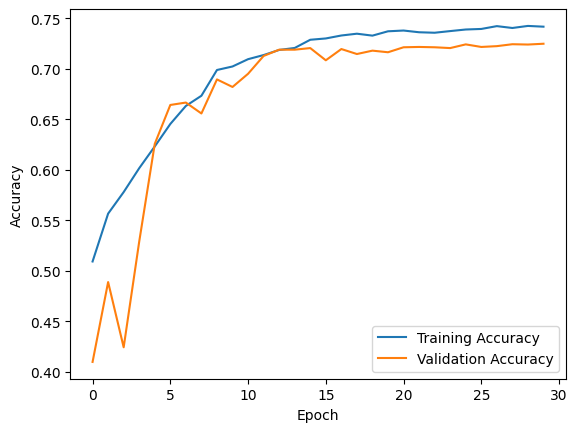

In [ ]:
# Define augmentation layers
image_aug_layers = [
    layers.RandomRotation(0.2),
    layers.RandomZoom(0.3)
]

# Define ResNet-specific parameters
filters_list = [64, 128, 256, 512]  # Filters for each ResNet block
dropout = 0.25                       # Dropout rate

# Define callbacks
reduce_lr = ReduceLROnPlateau(patience=1, factor=0.5, min_lr=1e-6)
timestp = TimestampCallback()
early = EarlyStopping(patience=10, restore_best_weights=False, verbose=1)

metrics = ['accuracy']
callbacks = [reduce_lr, timestp]

# Run ResNet model
history, model = run_resnet(
    shape='small',                    # Dataset shape
    filters_list=filters_list,        # Filters for each ResNet block
    dropout=dropout,                  # Dropout rate
    augmentation_layers=image_aug_layers,  # Data augmentation layers
    metrics=metrics,                  # Evaluation metrics
    callbacks=callbacks,              # Callbacks
    epochs=30,                        # Number of epochs
    return_model=True                 # Return the trained model
)

# Plot training history
import matplotlib.pyplot as plt

plt.plot(history['accuracy'], label='Training Accuracy')
plt.plot(history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [ ]:
# Run ResNet model
history_s_r = run_resnet(
    shape='small',                    # Dataset shape (e.g., 'small', 'medium', 'large')
    filters_list=[64, 128, 256, 512], # Filters for each ResNet block
    dropout=dropout,                  # Dropout rate
    augmentation_layers=image_aug_layers,  # Data augmentation layers
    callbacks=callbacks,              # Callbacks
    epochs=15                         # Number of epochs
)

Found 20946 files belonging to 3 classes.
Using 14663 files for training.
Using 6283 files for validation.
Epoch 1/15
459/459 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - accuracy: 0.4764 - loss: 1.0813 - val_accuracy: 0.5806 - val_loss: 0.8978 - learning_rate: 0.0010 - duration: 21.1151
Epoch 2/15
459/459 ━━━━━━━━━━━━━━━━━━━━ 12s 26ms/step - accuracy: 0.5547 - loss: 0.9395 - val_accuracy: 0.6015 - val_loss: 0.8785 - learning_rate: 0.0010 - duration: 12.1330
Epoch 3/15
459/459 ━━━━━━━━━━━━━━━━━━━━ 12s 26ms/step - accuracy: 0.5792 - loss: 0.8970 - val_accuracy: 0.5375 - val_loss: 1.0501 - learning_rate: 0.0010 - duration: 11.8497
Epoch 4/15
459/459 ━━━━━━━━━━━━━━━━━━━━ 12s 26ms/step - accuracy: 0.5936 - loss: 0.8620 - val_accuracy: 0.5649 - val_loss: 1.0308 - learning_rate: 5.0000e-04 - duration: 11.8598
Epoch 5/15
459/459 ━━━━━━━━━━━━━━━━━━━━ 12s 26ms/step - accuracy: 0.6177 - loss: 0.8284 - val_accuracy: 0.5357 - val_loss: 1.0659 - learning_rate: 2.5000e-04 - duration: 12.1648
Epoch 6/15
459/

In [ ]:
# Plot convergence for ResNet
plot_convergence(history=history_s_r)

In [ ]:
# Run ResNet model with data augmentation
history_sa_r = run_resnet(
    shape='small',                    # Dataset shape (e.g., 'small', 'medium', 'large')
    filters_list=[64, 128, 256, 512], # Filters for each ResNet block
    dropout=dropout,                  # Dropout rate
    augmentation_layers=image_aug_layers,  # Data augmentation layers
    callbacks=callbacks,              # Callbacks
    epochs=15                         # Number of epochs
)

Found 20946 files belonging to 3 classes.
Using 14663 files for training.
Using 6283 files for validation.
Epoch 1/15
459/459 ━━━━━━━━━━━━━━━━━━━━ 20s 29ms/step - accuracy: 0.4905 - loss: 1.0815 - val_accuracy: 0.4795 - val_loss: 1.2406 - learning_rate: 0.0010 - duration: 20.3473
Epoch 2/15
459/459 ━━━━━━━━━━━━━━━━━━━━ 12s 26ms/step - accuracy: 0.5589 - loss: 0.9301 - val_accuracy: 0.4710 - val_loss: 1.3406 - learning_rate: 0.0010 - duration: 11.8686
Epoch 3/15
459/459 ━━━━━━━━━━━━━━━━━━━━ 12s 26ms/step - accuracy: 0.5904 - loss: 0.8757 - val_accuracy: 0.5959 - val_loss: 0.8919 - learning_rate: 5.0000e-04 - duration: 12.0003
Epoch 4/15
459/459 ━━━━━━━━━━━━━━━━━━━━ 12s 25ms/step - accuracy: 0.6052 - loss: 0.8487 - val_accuracy: 0.4396 - val_loss: 1.3693 - learning_rate: 5.0000e-04 - duration: 11.7404
Epoch 5/15
459/459 ━━━━━━━━━━━━━━━━━━━━ 12s 26ms/step - accuracy: 0.6359 - loss: 0.8010 - val_accuracy: 0.5943 - val_loss: 0.9086 - learning_rate: 2.5000e-04 - duration: 12.0170
Epoch 6/15


In [ ]:
# Plot convergence for ResNet with data augmentation
plot_convergence(history=history_sa_r)

# Training Evaluation

In [ ]:
# To Extract summary statistics from training history including val accuracy, loss, learning rate, and duration

def get_history_means(history):
    if isinstance(history, dict):
        hist = history
    else:
        hist = history.history
    res = dict(
        epoch_counts = len(hist.get('accuracy')),
        max_val_acc = np.round(max(hist.get('val_accuracy')), 4),
        min_val_loss = np.round(min(hist.get('val_loss')), 4),
        min_lr = np.round(min(hist.get('learning_rate')), 4),
        tot_duration = np.sum(hist.get('duration')).astype(int),
    )
    return res

In [ ]:
# Prepare training summary table comparing different models, inputs, and augmentation settings

histories = [history_s,
             history_sa,
             history_s_x,
             history_sa_x,
             history_s_r,
             history_sa_r,
            ]

# Adjusted to match the length of histories (6 elements)
model = ['CNN'] * 2 + ['Xception'] * 2 + ['ResNet'] * 2  # 2 for each model type
input_data = ['small'] * 6  # All inputs are 'small'
augmentation = ['False', 'True'] * 3  # Alternating 'False' and 'True' for 6 elements

# Process histories data
histories_data = list(map(get_history_means, histories))
epoch_counts = list(map(lambda x: x.get('epoch_counts'), histories_data))
max_val_acc = list(map(lambda x: x.get('max_val_acc'), histories_data))
min_val_loss = list(map(lambda x: x.get('min_val_loss'), histories_data))
tot_duration = list(map(lambda x: x.get('tot_duration'), histories_data))

# Define header and cells for the table
header = dict(values=['Model type',
                      'Input data',
                      'Augmentation',
                      'Epoch counts',
                      'Max accuracy (val)',
                      'Min loss (val)',
                      'Total duration (s)'
                     ])

cells = dict(values=[model,
                     input_data,
                     augmentation,
                     epoch_counts,
                     max_val_acc,
                     min_val_loss,
                     tot_duration
                    ])

In [ ]:
# Display training results in a styled comparison table using Plotly

table = go.Figure(data=[go.Table(header=header, cells=cells)])
table.update_layout(paper_bgcolor='rgba(0,0,0,0)',
                    plot_bgcolor='rgba(0,0,0,0)',
                    margin=dict(l=0, r=0, t=0, b=0),
                    height=205
                   )
table.show()

# Final Model

In [ ]:
def plot_results(y_pred, y_true, title='Prediction stats', average='binary'):
    """
    Plot the results
    """
    cm = confusion_matrix(y_pred=y_pred, y_true=y_true, )
    ac = accuracy_score(y_pred=y_pred, y_true=y_true)
    f1 = f1_score(y_pred=y_pred, y_true=y_true, average=average)
    recall = recall_score(y_pred=y_pred, y_true=y_true, average=average)
    precision = precision_score(y_pred=y_pred, y_true=y_true, average=average)

    fig = make_subplots(
        rows=1,
        cols=2,
        column_widths=[0.75, 0.25]
    )
    fig.add_trace(
        go.Heatmap(
            z=cm,
            x=CATS,
            y=CATS,
            showscale=True,
            transpose=False,
            text=cm,
            textfont={"size": 30},
            texttemplate="%{text}",
            colorscale='viridis',
            xgap=8,
            ygap=8,
        ),
        row=1,
        col=2,

    )

    fig.add_trace(
        go.Bar(
            x=['Accuracy', "F1 score", "Recall", "Precision"],
            y=[ac, f1, recall, precision],
            marker=dict(
                color=[ac, f1, recall, precision],
                colorscale='Bluered',
                cmin=0,
                cmax=1,
                reversescale=True
            ),
            text=[ac, f1, recall, precision],
            texttemplate="%{text:.4f}",
            textfont={"size": 30}
        ),
        row=1,
        col=1
    )

    fig.update_layout(
        yaxis1_range=[0, 1],
        xaxis2_title="Predicted",
        yaxis2_title="Expected",
        title=title + f', (average = {average})',
        template='plotly_white'

    )

    return fig

def make_predictions(trained_model, test_ds):
    predictions = trained_model.predict(test_ds)
    pred_soft = tf.nn.softmax(predictions)
    y_pred = np.argmax(pred_soft, axis=1)
    y_true = np.concatenate([y for x, y in test_ds], axis=0)
    return y_pred, y_true


In [ ]:
# Load test dataset from 'small' directory with inferred labels and fixed image size

test_ds = keras.utils.image_dataset_from_directory(TEST_PATH.joinpath('small'),
                                                   labels='inferred',
                                                   image_size=(69, 69), shuffle=False)
test_ds.class_names


Found 8976 files belonging to 3 classes.


['E', 'S', 'SB']

In [ ]:
# Load training and validation datasets with inferred labels, splitting based on validation ratio

train, val = keras.utils.image_dataset_from_directory(TRAIN_PATH.joinpath('small'),
                                                       labels='inferred',
                                                       image_size=(69, 69),
                                                       shuffle=True,
                                                       subset='both',
                                                       validation_split=TRAIN_TEST_SPLIT,
                                                       seed=42
                                                      )
train.class_names

Found 20946 files belonging to 3 classes.
Using 14663 files for training.
Using 6283 files for validation.


['E', 'S', 'SB']

In [ ]:
# Optimize training and validation datasets using caching and prefetching for performance

train = train.cache().prefetch(buffer_size=AUTOTUNE)
val = val.cache().prefetch(buffer_size=AUTOTUNE)

# Testing on new data

In [ ]:
# Define image augmentation, model architecture parameters, and callbacks with early stopping for training

image_aug_layers = [
    layers.RandomRotation(0.2),
    layers.RandomZoom(0.3)
]
sizes = [128, 256, 512, 728, 1024]
dropout = 0.2

reduce_lr = ReduceLROnPlateau(patience=1, factor=0.5, min_lr=1e-6)
timestp = TimestampCallback()
early = EarlyStopping(patience=4, restore_best_weights=True, verbose=1)

metrics = ['accuracy']
callbacks = [reduce_lr, timestp, early]


In [ ]:
# Build, compile, and train an Xception model with augmentation and callbacks for early stopping

model = xception_model('small',
                       sizes,
                       dropout = dropout,
                       rescaling = True,
                       augmentation_layers = image_aug_layers
                      )

model.compile(optimizer=Adam(0.001),
              loss=keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=metrics)

history= model.fit(train,
                   validation_data=val,
                   callbacks=callbacks,
                   epochs=20)

Epoch 1/20
459/459 ━━━━━━━━━━━━━━━━━━━━ 36s 62ms/step - accuracy: 0.5079 - loss: 0.9896 - val_accuracy: 0.5680 - val_loss: 0.9614 - learning_rate: 0.0010 - duration: 35.5593
Epoch 2/20
459/459 ━━━━━━━━━━━━━━━━━━━━ 27s 58ms/step - accuracy: 0.6205 - loss: 0.8174 - val_accuracy: 0.6696 - val_loss: 0.7899 - learning_rate: 0.0010 - duration: 26.7837
Epoch 3/20
459/459 ━━━━━━━━━━━━━━━━━━━━ 27s 58ms/step - accuracy: 0.6639 - loss: 0.7563 - val_accuracy: 0.6753 - val_loss: 0.7297 - learning_rate: 0.0010 - duration: 26.6863
Epoch 4/20
459/459 ━━━━━━━━━━━━━━━━━━━━ 27s 58ms/step - accuracy: 0.6800 - loss: 0.7142 - val_accuracy: 0.6780 - val_loss: 0.7337 - learning_rate: 0.0010 - duration: 26.7665
Epoch 5/20
459/459 ━━━━━━━━━━━━━━━━━━━━ 27s 58ms/step - accuracy: 0.7093 - loss: 0.6670 - val_accuracy: 0.7079 - val_loss: 0.6618 - learning_rate: 5.0000e-04 - duration: 26.7372
Epoch 6/20
459/459 ━━━━━━━━━━━━━━━━━━━━ 27s 58ms/step - accuracy: 0.7190 - loss: 0.6424 - val_accuracy: 0.6834 - val_loss: 0.7

In [ ]:
plot_convergence(history=history, title=f"Final model, dropout = {dropout}")

Hyperparameter tuning to checking which dropout rate gives the best results for the model in terms of accuracy

In [ ]:
dropout = 0.3
reduce_lr = ReduceLROnPlateau(patience=1, factor=0.5, min_lr=1e-6)
timestp = TimestampCallback()
early = EarlyStopping(patience=4, restore_best_weights=True, verbose=1)

metrics = ['accuracy']
callbacks = [reduce_lr, timestp, early]

In [ ]:
model_1 = xception_model('small',
                       sizes,
                       dropout = dropout,
                       rescaling = True,
                       augmentation_layers = image_aug_layers
                      )

model_1.compile(optimizer=Adam(0.001),
              loss=keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=metrics)

history_1= model_1.fit(train,
                  validation_data=val,
                  callbacks=callbacks,
                  epochs=20)

Epoch 1/20
459/459 ━━━━━━━━━━━━━━━━━━━━ 33s 59ms/step - accuracy: 0.4969 - loss: 1.0055 - val_accuracy: 0.5709 - val_loss: 0.9657 - learning_rate: 0.0010 - duration: 33.2267
Epoch 2/20
459/459 ━━━━━━━━━━━━━━━━━━━━ 27s 58ms/step - accuracy: 0.6080 - loss: 0.8388 - val_accuracy: 0.5959 - val_loss: 1.0044 - learning_rate: 0.0010 - duration: 26.7211
Epoch 3/20
459/459 ━━━━━━━━━━━━━━━━━━━━ 27s 58ms/step - accuracy: 0.6671 - loss: 0.7442 - val_accuracy: 0.6818 - val_loss: 0.7533 - learning_rate: 5.0000e-04 - duration: 26.7034
Epoch 4/20
459/459 ━━━━━━━━━━━━━━━━━━━━ 27s 58ms/step - accuracy: 0.6893 - loss: 0.7048 - val_accuracy: 0.6807 - val_loss: 0.7395 - learning_rate: 5.0000e-04 - duration: 26.6735
Epoch 5/20
459/459 ━━━━━━━━━━━━━━━━━━━━ 27s 58ms/step - accuracy: 0.7018 - loss: 0.6830 - val_accuracy: 0.7145 - val_loss: 0.6700 - learning_rate: 5.0000e-04 - duration: 26.6462
Epoch 6/20
459/459 ━━━━━━━━━━━━━━━━━━━━ 27s 58ms/step - accuracy: 0.7109 - loss: 0.6621 - val_accuracy: 0.6694 - val_l

In [ ]:
plot_convergence(history=history_1, title=f"Final model, dropout = {dropout}")

In [ ]:
y_pred, y_true = make_predictions(model_1, test_ds)
plot_results(y_pred, y_true, title=f'Prediction stats, dropout = {dropout}', average='macro')

281/281 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step


# Final results

In [ ]:
correct = y_pred == y_true
files = list(map(lambda x: x.split("/")[-1].split(".")[0], test_ds.file_paths))

df_pred = pl.DataFrame({'correct': correct, 'asset_id': files})

In [ ]:
# Join prediction results with original DataFrame and cast 'correct' column to integer

pred_df = (
    df
    .with_columns(pl.col('asset_id').cast(pl.Utf8))
    .join(df_pred, on='asset_id')
    .with_columns(pl.col('correct').cast(pl.UInt8))
)
pred_df.head()

,dr7objid,asset_id,gz2class,total_classifications,total_votes,agreement,target,path_small,path_medium,path_large,correct
i64,i64,str,str,i64,i64,f64,str,str,str,str,u8
0,587732591714893851,"""58957""","""Sc+t""",45,342,1.0,"""S""","""/kaggle/input/resized-reduced-…","""/kaggle/input/resized-reduced-…","""/kaggle/input/resized-reduced-…",1
1,588009368545984617,"""193641""","""Sb+t""",42,332,1.0,"""S""","""/kaggle/input/resized-reduced-…","""/kaggle/input/resized-reduced-…","""/kaggle/input/resized-reduced-…",1
3,587741723357282317,"""158501""","""Sc+t""",28,218,0.766954,"""S""","""/kaggle/input/resized-reduced-…","""/kaggle/input/resized-reduced-…","""/kaggle/input/resized-reduced-…",1
10,587745403080146952,"""187749""","""Er""",51,191,0.340943,"""E""","""/kaggle/input/resized-reduced-…","""/kaggle/input/resized-reduced-…","""/kaggle/input/resized-reduced-…",1
24,588295841247592461,"""238289""","""Er""",33,110,0.349646,"""E""","""/kaggle/input/resized-reduced-…","""/kaggle/input/resized-reduced-…","""/kaggle/input/resized-reduced-…",1


In [ ]:
plot_df = pred_df.group_by(['target', 'correct']).agg(pl.mean('total_votes'))

fig = go.Figure()

for i, c in enumerate(["Bad classication", "Correct classification"]):
    d = plot_df.filter(pl.col('correct') == i).sort('target')
    x = d['target'].to_numpy()
    y = d['total_votes'].to_numpy()
    fig.add_traces(go.Bar(x=x,
                          y=y,
                          name=c
                         ))

fig.update_layout(barmode='group',
                  title='Mean vots per target and classification success',
                  xaxis=dict(title='Category'),
                  yaxis=dict(title='Mean votes'),
                 )

fig.show()


We observe that for the best-predicted category, Elliptical (E), the mean vote counts are quite similar for both correct and incorrect predictions. However, this isn’t the case for Spiral (S) and Barred Spiral (SB) galaxies, where correct classifications tend to have a higher average number of votes. This could indicate that in our dataset, reaching a reliable agreement on the type for S and SB galaxies requires a greater consensus—more votes—compared to E-type galaxies.

# Conclusion

Xception with image augmentation is giving the best accuracy of 74%, followed by ResNet (71%) and Custom CNN (69%)